<a id="99"></a>
# Python 8 Assignment
### Purpose: To Create and Optimize a Random Forest Classifier
<b>Program Sections</b>
<ul>
<li><a href = "#0">Import Python Packages</a></li>
<li><a href = "#1">Set Display</a></li>
<li><a href = "#2">Load the Data and Evaluate Fields</a></li>
<li><a href = "#3">Feature Engineering</a></li>  
<li><a href = "#4">Save the Dataframe as a CSV File</a></li>    
<li><a href = "#5">Determine Baseline Accuracy</a></li>    
<li><a href = "#6">Create Training (Validation) and Testing Datasets</a></li>
<li><a href = "#7">Create and Evaluate a Simple 5 Tree Random Forest</a></li>
<li><a href = "#8">Finding the Best Hyperparameters for a Random Forest</a></li>
<li><a href = "#9">Assignment Submission</a></li></ul>

<a id="0"></a>
### Import Python Packages
<a href = "#99">Top</a>

In [1]:
# Code Block 0
import numpy as np 
import pandas as pd 
import seaborn as sns

from matplotlib import pyplot as plt
from matplotlib import style
from IPython.display import Image

from sklearn import tree
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, RepeatedKFold, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report

<a id="1"></a>
### Set Display
<a href = "#99">Top</a>

In [2]:
# Code Block 1
# Set display to show up to 100 columns in dataframe
pd.set_option('display.max_columns',100) 

# Set plot style
plt.style.use('seaborn')

<a id="2"></a>
### Load the Data and Evaluate Fields
<a href = "#99">Top</a>

In [3]:
# Code Block 2
# Read CSV file into dataframe
df_cellco = pd.read_csv("Cellco Churn Data - Cleaned.csv",encoding="latin1")

In [5]:
# Code Block 3
# Fields and data that are available in the dataframe ... and position
df_cellco.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 43 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Customer ID                            7043 non-null   object 
 1   Gender                                 7043 non-null   int64  
 2   Senior Citizen                         7043 non-null   int64  
 3   Spouse/Partner                         7043 non-null   int64  
 4   Dependents                             7043 non-null   int64  
 5   Tenure                                 7043 non-null   int64  
 6   Phone Service                          7043 non-null   int64  
 7   Monthly Charges                        7043 non-null   float64
 8   Lifetime Charges                       7043 non-null   float64
 9   Retained                               7043 non-null   int64  
 10  Multiple Lines=No                      7043 non-null   int64  
 11  Mult

In [7]:
# Code Block 4
# What does the actual data look like?
df_cellco.sample(10)

,Customer ID,Gender,Senior Citizen,Spouse/Partner,Dependents,Tenure,Phone Service,Monthly Charges,Lifetime Charges,Retained,Multiple Lines=No,Multiple Lines=No Phone Service,Multiple Lines=Yes,Internet Service=DSL,Internet Service=Fiber optic,Internet Service=No,Online Security=No,Online Security=No Internet Service,Online Security=Yes,Online Backup=No,Online Backup=No Internet Service,Online Backup=Yes,Device Protection=No,Device Protection=No Internet Service,Device Protection=Yes,Tech Support=No,Tech Support=No Internet Service,Tech Support=Yes,Streaming TV=No,Streaming TV=No Internet Service,Streaming TV=Yes,Streaming Movies=No,Streaming Movies=No Internet Service,Streaming Movies=Yes,Contract=Month-to-month,Contract=One year,Contract=Two year,Paperless Billing=No,Paperless Billing=Yes,Payment Method=Bank Transfer,Payment Method=Credit Card,Payment Method=Electronic check,Payment Method=Mailed check
471,0689-DSXGL,0,0,1,1,52,1,85.80,4433.30,1,1,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,1,1,0,0,1,0,0,1,0,0,1,0,1,0,0,0
5964,8404-VIOMB,0,0,0,0,66,0,62.50,4136.40,1,0,1,0,1,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,1,1,0,0,0
5635,7943-RQCHR,0,0,0,0,9,1,94.75,889.90,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,1,0,0,1,0
4119,5828-AVIPD,1,0,1,1,19,1,100.95,1875.55,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0
6450,9134-CEQMF,1,1,1,0,7,1,89.50,676.70,0,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,1,0,0,1,0
3414,4836-WNFNO,0,0,1,0,72,1,25.00,1849.20,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,1,0,0,1,0,0
4306,6072-NUQCB,1,0,1,1,22,1,20.25,488.25,1,1,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0
4185,5915-ANOEI,1,0,1,0,70,1,79.15,5536.50,1,0,0,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,1,0,0,0,0,1
3674,5181-OABFK,0,0,1,1,56,1,61.30,3346.80,1,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,1,0,0,1,0,0,1,0,0,0,0,1,0,1,0,1,0,0
6523,9254-RBFON,0,0,1,1,17,1,98.60,1704.95,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0


In [8]:
# Code Block 5
# Field names for easy copying
df_cellco.columns

Index(['Customer ID', 'Gender', 'Senior Citizen', 'Spouse/Partner',
       'Dependents', 'Tenure', 'Phone Service', 'Monthly Charges',
       'Lifetime Charges', 'Retained', 'Multiple Lines=No',
       'Multiple Lines=No Phone Service', 'Multiple Lines=Yes',
       'Internet Service=DSL', 'Internet Service=Fiber optic',
       'Internet Service=No', 'Online Security=No',
       'Online Security=No Internet Service', 'Online Security=Yes',
       'Online Backup=No', 'Online Backup=No Internet Service',
       'Online Backup=Yes', 'Device Protection=No',
       'Device Protection=No Internet Service', 'Device Protection=Yes',
       'Tech Support=No', 'Tech Support=No Internet Service',
       'Tech Support=Yes', 'Streaming TV=No',
       'Streaming TV=No Internet Service', 'Streaming TV=Yes',
       'Streaming Movies=No', 'Streaming Movies=No Internet Service',
       'Streaming Movies=Yes', 'Contract=Month-to-month', 'Contract=One year',
       'Contract=Two year', 'Paperless Billing=N

<a id="3"></a>
### Feature Engineering
<a href = "#99">Top</a>

In [11]:
# Code Block 6
# Aggregate total services utilized
df_cellco['Total Services'] = df_cellco.iloc[:,[6,12,13,14,18,21,24,27,30,33]].sum(axis=1)

<a id="4"></a>
### Save the Dataframe as a CSV File
<a href = "#99">Top</a>

In [12]:
# Code Block 7
# Save the dataframe as a CSV file for the next assignment
df_cellco.to_csv('Cellco Churn Data - Features.csv', index=False)

<a id="5"></a>
### Determine Baseline Accuracy
<a href = "#99">Top</a>

In [13]:
# Code Block 8
# Baseline accuracy is if we predicted all individuals would remain or churn
# This is the standard that needs to be improved upon
df_cellco['Retained'].value_counts(normalize = True).mul(100).round(1).astype(str) + '%'

1    73.5%
0    26.5%
Name: Retained, dtype: object

<a id="6"></a>
### Create Training (Validation) and Testing Datasets
<a href = "#99">Top</a>

In [14]:
# Code Block 9
# Create a list of features to be utilized
X_names = df_cellco.columns.values.tolist()
X_names.remove('Customer ID')
X_names.remove('Retained')

# Create X matrix of features
X = df_cellco[X_names].copy()

# Create y vector of retained results
y = df_cellco[['Retained']].copy()

In [15]:
# Code Block 10
# Split the data into 80% training and 20% testing data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .20, random_state=42)

<a id="7"></a>
### Create and Evaluate a Simple 5 Tree Random Forest
<a href = "#99">Top</a>

In [16]:
# Code Block 11
# Create a random forest model with five 4-feature trees of no more than 3 levels
weights = {0:.75, 1:.25}

random_forest = RandomForestClassifier(n_estimators=5, max_features=4, max_depth=3, 
                                       class_weight=weights, random_state=42)

rf_simple = random_forest.fit(X_train,y_train.values.ravel())  # RandomForestClassifier requires target in a flattened array

# Show the five decision trees in the random forest
fig, axes = plt.subplots(nrows = 1,ncols = 5,figsize = (94,8), dpi=400)
 
for i in range(0,5):
    tree.plot_tree(rf_simple.estimators_[i], feature_names=X_names, class_names=['Churned', 'Retained'], 
                   rounded=True, proportion=False, precision=3, filled=True, fontsize=10, ax = axes[i])
    axes[i].set_title('Tree: ' + str(i), fontsize = 36)

# Save file with rendering of trees
plt.savefig('rf_simple_5trees.jpg')

##### Evaluate Performance of Random Forest

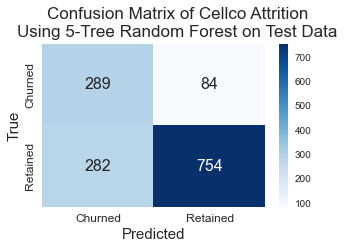

In [17]:
# Code Block 12
# Predict outcomes using random forest on test data
y_pred_test = rf_simple.predict(X_test)

# Create a confusion matrix showing the predicted and true results
cm = confusion_matrix(y_test, y_pred_test)

# Create a heat map showing the results of the confusion matrix for the test data
fig, axes = plt.subplots(nrows=1, ncols=1, sharex=True, figsize=(5, 3))
fig.suptitle('Confusion Matrix of Cellco Attrition\nUsing 5-Tree Random Forest on Test Data', 
             fontsize=17, y=1.05)
ax = plt.subplot()
sns.heatmap(cm, annot=True, cmap="Blues", annot_kws={"size": 16}, ax=ax, fmt="g")
ax.set_xlabel('Predicted', fontsize=15)
ax.set_ylabel('True', fontsize=15)
ax.xaxis.set_ticklabels(['Churned', 'Retained'], fontsize=12)
ax.yaxis.set_ticklabels(['Churned', 'Retained'], fontsize=12, va='center')
plt.show()

In [19]:
# Code Block 13
# Show statistics on random forest performance on test data
print("Results from 5-Tree Random Forest - Testing Data")
print("Accuracy: "+"{:.2%}".format(accuracy_score(y_test, y_pred_test)))
print("Report: \n", classification_report(y_test, y_pred_test, 
                                          target_names=['Churned', 'Retained'], digits=3)) 

# Show results from training data
y_train_pred = rf_simple.predict(X_test) 
print("\nResults from 5-Tree Random Forest - Training Data")
print("Accuracy: "+"{:.2%}".format(accuracy_score(y_test, y_train_pred)))

Results from 5-Tree Random Forest - Testing Data
Accuracy: 74.02%
Report: 
               precision    recall  f1-score   support

     Churned      0.506     0.775     0.612       373
    Retained      0.900     0.728     0.805      1036

    accuracy                          0.740      1409
   macro avg      0.703     0.751     0.708      1409
weighted avg      0.796     0.740     0.754      1409


Results from 5-Tree Random Forest - Training Data
Accuracy: 74.02%


##### Evaluate Feature Importance

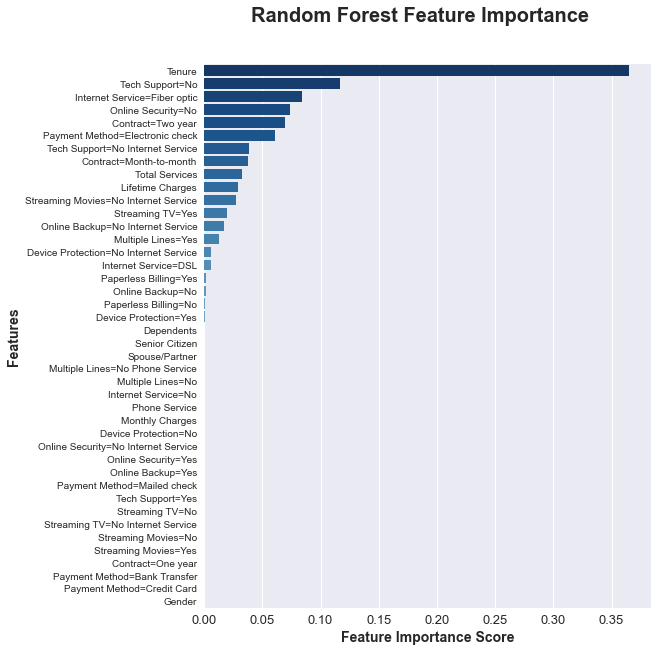

In [20]:
# Code Block 14
# Show overall importance of the features in the 5 trees
feature_imp = pd.Series(rf_simple.feature_importances_,index=X_names).sort_values(ascending=False)

# Create a bar plot of feature importance
fig, axes = plt.subplots(sharex = True, figsize=(8, 10))
sns.barplot(x=feature_imp, y=feature_imp.index, palette = "Blues_r")
plt.ylabel('Features', fontsize = 14, fontweight='bold')
plt.xlabel('Feature Importance Score', fontsize = 14, fontweight='bold')
plt.xticks(fontsize = 13, ha = "center")
plt.suptitle("Random Forest Feature Importance", fontweight='bold', fontsize=20, y = .96)
plt.show()

<a id="8"></a>
### Finding the Best Hyperparameters for a Random Forest
<a href = "#99">Top</a>

In [21]:
# Code Block 15
# Set up Search Grid possibilities
random_grid = {'n_estimators': [int(x) for x in np.linspace(start = 400, stop = 2000, num = 5)],
               'max_features': ['auto', 'sqrt'],
               'max_depth': [int(x) for x in np.linspace(2, 14, num = 7)],
               'min_samples_split': [25,50,100,200],
               'min_samples_leaf': [10,20,50],
               'bootstrap': [True, False]}

# Show grid settings
random_grid

{'n_estimators': [400, 800, 1200, 1600, 2000],
 'max_features': ['auto', 'sqrt'],
 'max_depth': [2, 4, 6, 8, 10, 12, 14],
 'min_samples_split': [25, 50, 100, 200],
 'min_samples_leaf': [10, 20, 50],
 'bootstrap': [True, False]}

In [22]:
# Code Block 16
# Random search of parameters, using 3 fold cross validation, 
# Search across 100 combinations of hyperparameters. Use all but one CPU core to do this
rf_random = RandomizedSearchCV(estimator=RandomForestClassifier(class_weight=weights), 
                               param_distributions=random_grid, n_iter=100, cv=3, 
                               verbose=2, random_state=42, n_jobs=-2)

# Fit the random search model
rf_random.fit(X_train, y_train.values.ravel())

Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 3 concurrent workers.
[Parallel(n_jobs=-2)]: Done  35 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-2)]: Done 156 tasks      | elapsed:  6.6min
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed: 12.6min finished


RandomizedSearchCV(cv=3,
                   estimator=RandomForestClassifier(class_weight={0: 0.75,
                                                                  1: 0.25}),
                   n_iter=100, n_jobs=-2,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [2, 4, 6, 8, 10, 12, 14],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [10, 20, 50],
                                        'min_samples_split': [25, 50, 100, 200],
                                        'n_estimators': [400, 800, 1200, 1600,
                                                         2000]},
                   random_state=42, verbose=2)

In [23]:
# Code Block 17
# Show hyperparameters from best Random Forest 
rf_random.best_params_

{'n_estimators': 1200,
 'min_samples_split': 25,
 'min_samples_leaf': 10,
 'max_features': 'auto',
 'max_depth': 10,
 'bootstrap': True}

##### Evaluate Performance of Best Random Forest

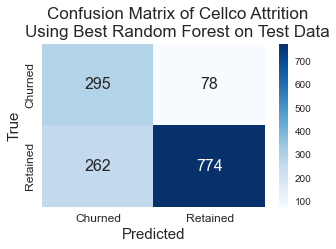

In [25]:
# Code Block 18/ use numbers from top row of confusion matrix
# Create a random forest model using best hyperparameters
random_forest = RandomForestClassifier(class_weight=weights, n_estimators=1200, 
                                       min_samples_split=25,  min_samples_leaf=10,
                                       max_features='auto', random_state=42, 
                                       max_depth=10, bootstrap=True)
rf_best = random_forest.fit(X_train,y_train.values.ravel())

# Predict outcomes using random forest on test data
y_pred_test = rf_best.predict(X_test)

# Create a confusion matrix showing the predicted and true results
cm = confusion_matrix(y_test, y_pred_test) 

# Create a heat map showing the results of the confusion matrix for the test data
fig, axes = plt.subplots(nrows=1, ncols=1, sharex=True, figsize=(5, 3))
fig.suptitle('Confusion Matrix of Cellco Attrition\nUsing Best Random Forest on Test Data', 
             fontsize=17, y = 1.05)
ax = plt.subplot()
sns.heatmap(cm, annot=True, cmap="Blues", annot_kws={"size": 16}, ax=ax, fmt="g")
ax.set_xlabel('Predicted', fontsize=15)
ax.set_ylabel('True', fontsize=15)
ax.xaxis.set_ticklabels(['Churned', 'Retained'], fontsize=12)
ax.yaxis.set_ticklabels(['Churned', 'Retained'], fontsize=12, va='center')
plt.show()

In [26]:
# Code Block 19
# Show statistics on random forest on test data
print("Results from Best Random Forest - Testing Data")
print("Accuracy: "+"{:.2%}".format(accuracy_score(y_test, y_pred_test)))
print("Report: \n", classification_report(y_test, y_pred_test, 
                                          target_names=['Churned', 'Retained'], digits=3)) 

# Show results from training data
y_train_pred = rf_best.predict(X_train) 
print("\nResults from Best Random Forest - Training Data")
print("Accuracy: "+"{:.2%}".format(accuracy_score(y_train, y_train_pred)))

Results from Best Random Forest - Testing Data
Accuracy: 75.87%
Report: 
               precision    recall  f1-score   support

     Churned      0.530     0.791     0.634       373
    Retained      0.908     0.747     0.820      1036

    accuracy                          0.759      1409
   macro avg      0.719     0.769     0.727      1409
weighted avg      0.808     0.759     0.771      1409


Results from Best Random Forest - Training Data
Accuracy: 78.90%


NameError: name 'feature_best_imp' is not defined

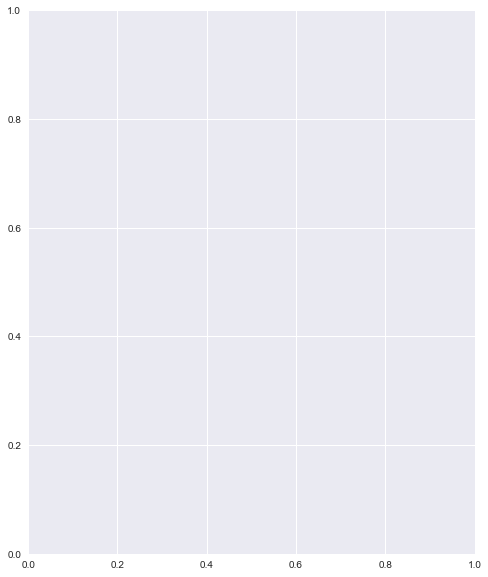

In [28]:
# Code Block 20
# Show overall importance of the features in the decision trees
feature_imp = pd.Series(rf_best.feature_importances_,index=X_names).sort_values(ascending=False)

# Create a bar plot of feature importance
fig, axes = plt.subplots(sharex=True, figsize=(8, 10))
sns.barplot(x=feature_imp, y=feature_best_imp, palette="Blues_r")
plt.ylabel('Features', fontsize=14, fontweight='bold')
plt.xlabel('Feature Importance Score', fontsize=14, fontweight='bold')
plt.xticks(fontsize=13, ha="center")
plt.suptitle("Random Forest Feature Importance", fontweight='bold', fontsize=20, y=.92)
plt.show()

##### Show Individual Decision Trees in Random Forest

In [29]:
# Code Block 21
# Draw decision tree graphically
plt.figure(figsize=(120,8), dpi=300)
tree.plot_tree(rf_best.estimators_[1], feature_names=X_names, class_names=['Churned', 'Retained'], 
               rounded=True, proportion=False, precision=3, filled=True, fontsize=6)

plt.savefig('rf_best_tree01.jpg')

In [30]:
# Code Block 22
# Draw decision tree graphically
plt.figure(figsize=(120,8), dpi=300)
tree.plot_tree(rf_best.estimators_[12], feature_names=X_names, class_names=['Churned', 'Retained'], 
               rounded=True, proportion=False, precision=3, filled=True, fontsize=6)

plt.savefig('rf_best_tree12.jpg')

##### Predicting with Best Random Forest

In [31]:
# Code Block 23
# Create empty copy of dataframe used in model
df_predNew = X_test.head(0).copy()

# Create a prediction probability for the following person:
# Individual is a 45-year-old male. He is married and has two children. He has had phone 
# service with the company for 1 year, with monthly charges of $36 and total charges incurred to 
# date of $453.  He has two phone lines and internet service connection via fiber optics; no 
# additional intenet services have been purchased although he does stream TV and movies. His 
# contract has a single year basis and payments are made via bank transfer. Bills are paperless.
df_predNew.loc[0] = [1,0,1,1,12,1,36,453,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,1,0,0,0,5]
df_predNew

,Gender,Senior Citizen,Spouse/Partner,Dependents,Tenure,Phone Service,Monthly Charges,Lifetime Charges,Multiple Lines=No,Multiple Lines=No Phone Service,Multiple Lines=Yes,Internet Service=DSL,Internet Service=Fiber optic,Internet Service=No,Online Security=No,Online Security=No Internet Service,Online Security=Yes,Online Backup=No,Online Backup=No Internet Service,Online Backup=Yes,Device Protection=No,Device Protection=No Internet Service,Device Protection=Yes,Tech Support=No,Tech Support=No Internet Service,Tech Support=Yes,Streaming TV=No,Streaming TV=No Internet Service,Streaming TV=Yes,Streaming Movies=No,Streaming Movies=No Internet Service,Streaming Movies=Yes,Contract=Month-to-month,Contract=One year,Contract=Two year,Paperless Billing=No,Paperless Billing=Yes,Payment Method=Bank Transfer,Payment Method=Credit Card,Payment Method=Electronic check,Payment Method=Mailed check,Total Services
0,1,0,1,1,12,1,36.0,453.0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,1,0,0,0,5


In [32]:
# Code Block 25
# Predict probabilty that customer will churn from created random forest
newObs_PredProb = rf_best.predict_proba(df_predNew)[:,0][0]
print("Probabilty that Customer will Churn: "+"{:.2%}".format(newObs_PredProb))

Probabilty that Customer will Churn: 39.31%


<a id="9"></a>
### Assignment Submission
<a href = "#99">Top</a>

## Python Assignment 8
### Name: George Gannon

In [34]:
# Draw decision tree graphically
plt.figure(figsize=(120,8), dpi=300)
tree.plot_tree(rf_best.estimators_[24], feature_names=X_names, class_names=['Churned', 'Retained'], 
               rounded=True, proportion=False, precision=3, filled=True, fontsize=6)
plt.show()

In [35]:
import datetime, socket
print(datetime.datetime.now().isoformat())
print("Your Computer Name is: " + socket.gethostname())
print("Your Computer IP Address is: " + socket.gethostbyname(socket.gethostname()))

2020-11-10T16:05:08.595658
Your Computer Name is: DESKTOP-0VRDGNF
Your Computer IP Address is: 192.168.1.139
